In [1]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from google.colab import files
from PIL import Image
from google.colab import drive
drive.mount('/content/drive')
path = "/content/drive/MyDrive/Cubinho/Assets/"

Mounted at /content/drive


In [2]:
RF=cv2.imread(path+'RF.jpg',1)
RFhsv = cv2.cvtColor(RF,cv2.COLOR_BGR2HSV_FULL)
GF=cv2.imread(path+'GF.jpg',1)
GFhsv = cv2.cvtColor(GF,cv2.COLOR_BGR2HSV_FULL)
WF=cv2.imread(path+'WF.jpg',1)
WFhsv = cv2.cvtColor(WF,cv2.COLOR_BGR2HSV_FULL)
YF=cv2.imread(path+'YF.jpg',1)
YFhsv = cv2.cvtColor(YF,cv2.COLOR_BGR2HSV_FULL)
OF=cv2.imread(path+'OF.jpg',1)
OFhsv = cv2.cvtColor(OF,cv2.COLOR_BGR2HSV_FULL)
BF=cv2.imread(path+'BF.jpg',1)
BFhsv = cv2.cvtColor(BF,cv2.COLOR_BGR2HSV_FULL)

In [3]:
def acha_cubo(img):
  img_ = img.copy()
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)[1]
  kernel = np.ones((5,5),np.uint8)
  dilation = cv2.dilate(thresh,kernel,iterations = 1)
  #cv2_imshow(dilation)
  cnts = cv2.findContours(dilation, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cnts = cnts[0] if len(cnts) == 2 else cnts[1]
  for cnt in cnts:
    #cv2.drawContours(img_,[cnt],0,255,-1)
    area = cv2.contourArea(cnt)
  
    if(area > 1000000):
      #print(area)
      x, y, w, h = cv2.boundingRect(cnt)
      cv2.rectangle(img_, (x, y), (x + w, y + h), (0, 0, 255), 4)

  cv2_imshow(img_)

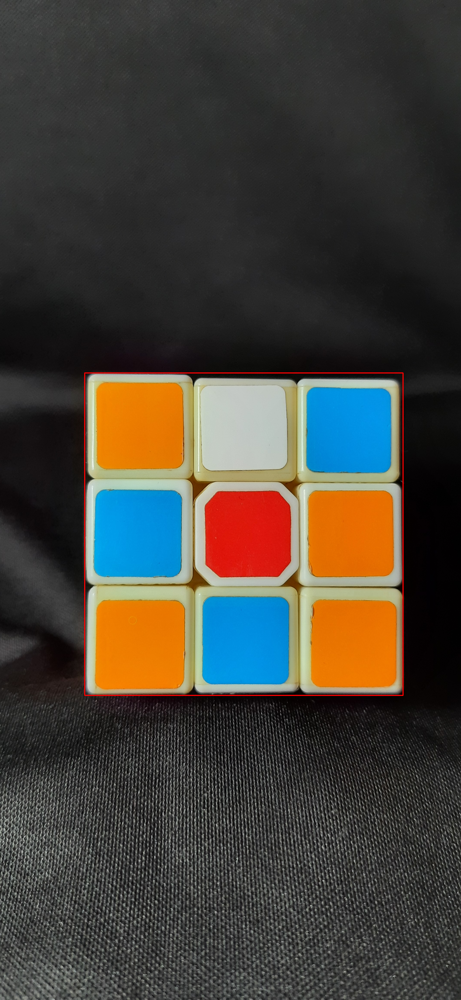

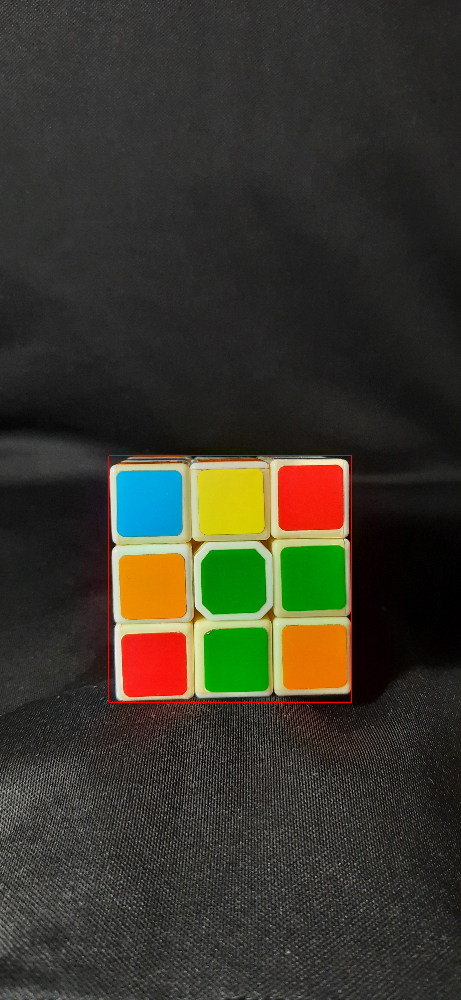

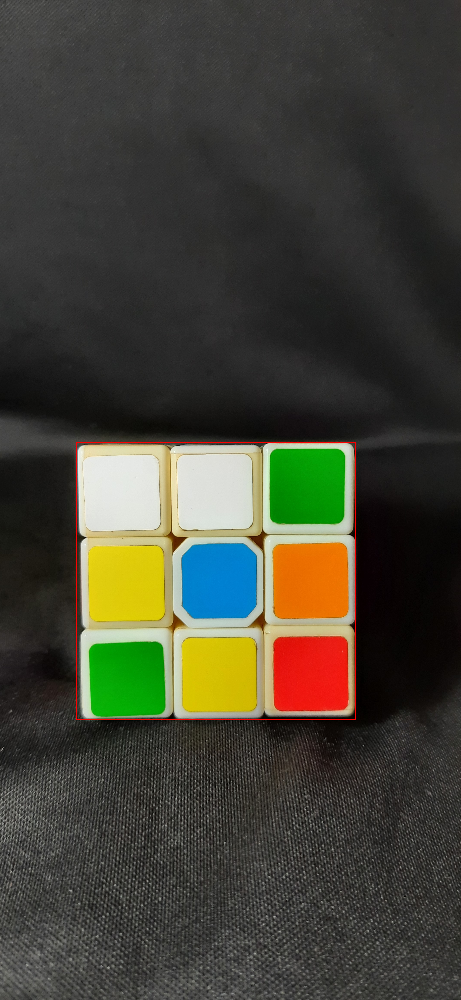

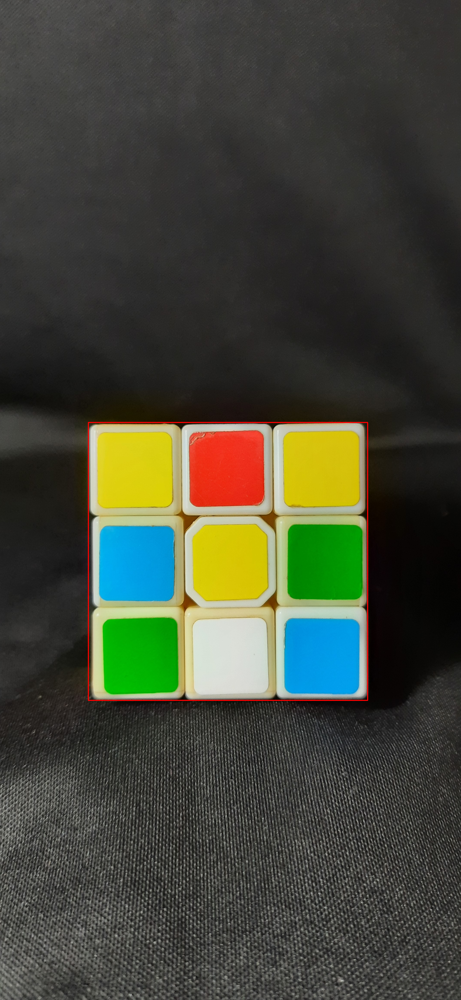

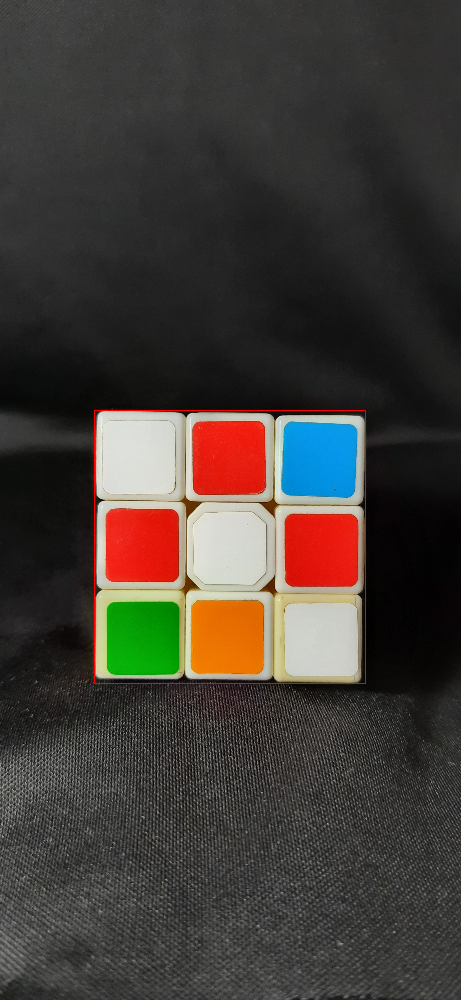

Buffered data was truncated after reaching the output size limit.

In [ ]:
acha_cubo(RF)
acha_cubo(GF)
acha_cubo(BF)
acha_cubo(YF)
acha_cubo(WF)
acha_cubo(OF)


In [ ]:
def filtra(hsv_img):
  lower_red   = np.array([0, 110, 153])
  upper_red   = np.array([19, 240, 255])
  lower_green = np.array([47, 115, 38])
  upper_green = np.array([128, 255, 206])
  lower_white = np.array([0, 0, 164])
  upper_white = np.array([255,22,255])
  lower_yellow= np.array([31, 158, 163])
  upper_yellow= np.array([71, 255, 255])
  lower_orange= np.array([15, 172, 122])
  upper_orange= np.array([30, 255, 255])
  lower_blue  = np.array([120,30,158])
  upper_blue  = np.array([200,255,255])

  red_mask  = cv2.inRange(hsv_img, lower_red, upper_red)
  green_mask = cv2.inRange(hsv_img, lower_green, upper_green)
  white_mask = cv2.inRange(hsv_img, lower_white, upper_white)
  yellow_mask= cv2.inRange(hsv_img, lower_yellow, upper_yellow)
  orange_mask= cv2.inRange(hsv_img, lower_orange, upper_orange)
  blue_mask  = cv2.inRange(hsv_img, lower_blue, upper_blue)

  mask = cv2.bitwise_or(red_mask, green_mask)
  mask = cv2.bitwise_or(white_mask, mask)
  mask = cv2.bitwise_or(yellow_mask, mask)
  mask = cv2.bitwise_or(orange_mask, mask)
  mask = cv2.bitwise_or(blue_mask, mask)

  result = cv2.bitwise_and(hsv_img, hsv_img, mask = mask)
  cv2_imshow(cv2.cvtColor(result, cv2.COLOR_HSV2BGR))
  return result